# Time derivated effects

In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from dask.distributed import Client
import xrsignal
import hvplot.xarray
import seaborn as sns
import xrft
from ni_tools import inversion
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

In [2]:
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 8
Total threads: 32,Total memory: 62.79 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:42367,Workers: 8
Dashboard: http://127.0.0.1:8787/status,Total threads: 32
Started: Just now,Total memory: 62.79 GiB
Comm: tcp://127.0.0.1:39535,Total threads: 4
Dashboard: http://127.0.0.1:33937/status,Memory: 7.85 GiB
Nanny: tcp://127.0.0.1:38799,


In [3]:
fn = '/datadrive/NCCFs/averaged/201.nc'
NCCFs = xr.open_dataarray(fn).chunk({'time':100, 'delay':11999})
NCCFs.name = 'NCCFs'
dNCCFs = NCCFs.differentiate('delay')

## compare with plots

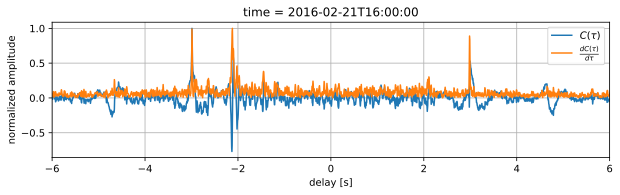

In [26]:
fig = plt.figure(figsize=(10,2.5))
NCCF.plot(label='$C(\\tau)$')
dNCCFc.plot(label='$\\frac{dC(\\tau)}{d\\tau}$')

plt.xlim([-6,6])
plt.grid()
plt.xlabel('delay [s]')
plt.ylabel('normalized amplitude')
plt.legend()

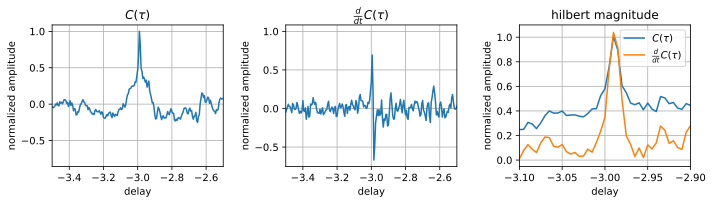

In [5]:
fig = plt.figure(figsize=(10,3))
plt.subplot(1,3,1)
NCCF.plot(label='$C(\\tau)$')
plt.grid()
plt.xlim([-3.5,-2.5])
plt.ylabel('normalized amplitude')
plt.title('$C(\\tau)$')

plt.subplot(1,3,2)
dNCCF.plot(label='$\\frac{d}{dt}C(\\tau)$')
plt.grid()
plt.xlim([-3.5,-2.5])
plt.ylabel('normalized amplitude')
plt.title('$\\frac{d}{dt}C(\\tau)$')

plt.subplot(1,3,3)
plt.tight_layout()
np.abs(xrsignal.hilbert(NCCF, 'delay')).plot(label='$C(\\tau)$')
np.abs(xrsignal.hilbert(dNCCF, 'delay')).plot(label='$\\frac{d}{dt}C(\\tau)$')
plt.grid()
plt.xlim([-3.1,-2.9])
plt.ylabel('normalized amplitude')
plt.title('hilbert magnitude')
plt.legend()

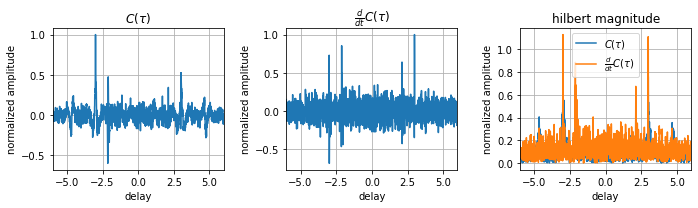

In [56]:
fig = plt.figure(figsize=(10,3))
plt.subplot(1,3,1)
NCCF.plot(label='$C(\\tau)$')
plt.grid()
plt.xlim([-6,6])
plt.ylabel('normalized amplitude')
plt.title('$C(\\tau)$')

plt.subplot(1,3,2)
dNCCF.plot(label='$\\frac{d}{dt}C(\\tau)$')
plt.grid()
plt.xlim([-6, 6])
plt.ylabel('normalized amplitude')
plt.title('$\\frac{d}{dt}C(\\tau)$')

plt.subplot(1,3,3)
plt.tight_layout()
np.abs(xrsignal.hilbert(NCCF, 'delay')).plot(label='$C(\\tau)$')
np.abs(xrsignal.hilbert(dNCCF, 'delay')).plot(label='$\\frac{d}{dt}C(\\tau)$')
plt.grid()
plt.xlim([-6,6])
plt.ylabel('normalized amplitude')
plt.title('hilbert magnitude')
plt.legend()

### arrival time series

In [78]:
fn = '/datadrive/NCCFs/arrival_times/201hr_1-90Hz_derivative.nc'
atd = xr.open_dataset(fn)

fn = '/datadrive/NCCFs/arrival_times/201hr_1-90Hz.nc'
at = xr.open_dataset(fn)

fn = '/datadrive/simulation/caldera_inversion_timeseries_HYCOM2.nc'
tdgf = xr.open_dataarray(fn)
at_sim = inversion.calculate_arrival_times(tdgf, dim='time', peaks={'s1b0':slice(2.5, 3.5)})['s1b0']

In [98]:
fn = '/datadrive/HYCOM_data/Axial_Seamount_earthengine/*.nc'
HYCOM = xr.open_mfdataset(fn)

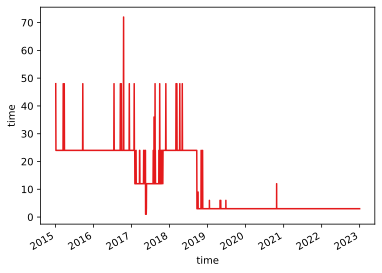

In [105]:
(HYCOM.time.diff('time')/1e9/3600).plot()

In [94]:
86400000000000/1e9/3600

24.0

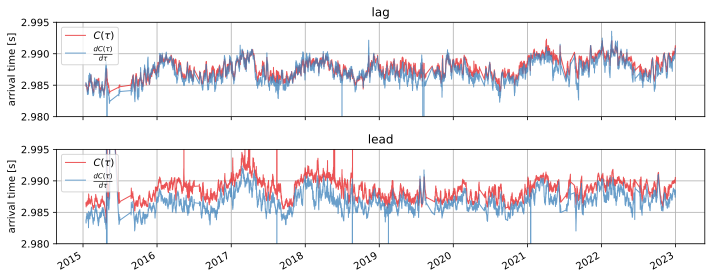

In [32]:
sns.set_palette("Set1")

fig = plt.figure(figsize=(10,4))

plt.subplot(2,1,1)
(at['s1b0A']*-1).plot(linewidth=1, label='$C(\\tau)$', alpha=0.75)
(atd['s1b0A']*-1).plot(linewidth=1, label='$\\frac{dC(\\tau)}{d\\tau}$', alpha=0.75)

plt.ylim([2.98, 2.995])
plt.xlabel('')
plt.ylabel('arrival time [s]')
plt.grid()
plt.legend()
plt.title('lag')
plt.gca().set_xticklabels('')

plt.subplot(2,1,2)
(at['s1b0B']).plot(linewidth=1, label='$C(\\tau)$', alpha=0.75)
(atd['s1b0B']).plot(linewidth=1, label='$\\frac{dC(\\tau)}{d\\tau}$', alpha=0.75)

plt.ylim([2.98, 2.995])
plt.xlabel('')
plt.ylabel('arrival time [s]')
plt.grid()
plt.title('lead')
plt.legend()

plt.tight_layout()

In [58]:
s1b0_f = xrsignal.welch(atd[['s1b0A', 's1b0B']].chunk({'time':61028}), fs=1, dim='time', nperseg=4096*2).isel({'time':0}).rename({'time_frequency':'period'})

In [59]:
s1b0_f = s1b0_f.assign_coords({'period':1/s1b0_f.period})

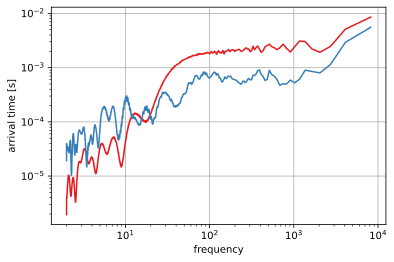

In [60]:
s1b0_f['s1b0A'].plot(x='period')
s1b0_f['s1b0B'].plot(x='period')
plt.yscale('log')
plt.xscale('log')
plt.xlabel('frequency')
plt.ylabel('arrival time [s]')
plt.grid()

In [123]:
at_sim_int = at_sim.interp({'date':atd.time.values}, method='cubic').rename({'date':'time'})

In [132]:
(-1*atd['s1b0A'] - 0.005).hvplot.scatter(s=1) * (atd['s1b0B'] - 0.005).hvplot.scatter(s=1) * at_sim_int.hvplot.scatter(s=1)

:Overlay
   .Scatter.I   :Scatter   [time]   (s1b0A)
   .Scatter.II  :Scatter   [time]   (s1b0B)
   .Scatter.III :Scatter   [time]   (s1b0)

In [128]:
error = (-1*atd['s1b0A'] - at_sim_int)
error.name = 'error'

error.hvplot()

:Curve   [time]   (error)

### calculate arrival times with time derivative


In [5]:
dNCCFs = np.abs(xrsignal.hilbert(NCCFs.differentiate('delay').sel({'delay':slice(-10,10)}), 'delay')).compute()

In [29]:
dNCCFs_interp = dNCCFs.sel({'delay':slice(2.9, 3.1)}).dropna(dim='time').interp({'delay':np.arange(2.9, 3.1, 0.001)}, method='cubic')

NCCFs_interp = NCCFs.sel({'delay':slice(-3.1, -2.9)}).dropna(dim='time').interp({'delay':np.arange(-3.1, -2.9, 0.001)}, method='cubic').compute()

In [30]:
NCCFs_interp.hvplot.image(x='time', rasterize=True, cmap='rocket')

:DynamicMap   []
   :Image   [time,delay]   (NCCFs)

In [23]:
dNCCFs_interp.hvplot.image(x='time', rasterize=True, cmap='rocket')

:DynamicMap   []
   :Image   [time,delay]   (NCCFs)

In [7]:
dNCCFs.hvplot.image(x='time', cmap='rocket', rasterize=True, ylim=(-6,6), title='dC/dtau')

:DynamicMap   []
   :Image   [time,delay]   (NCCFs)

## emergence study

In [1]:
import xarray as xr
import pandas as pd
import numpy as np
from ni_tools import emergence, utils
from dask.distributed import Client
import matplotlib.pyplot as plt
from tqdm import tqdm

In [5]:
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 8
Total threads: 32,Total memory: 62.79 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:41811,Workers: 8
Dashboard: http://127.0.0.1:8787/status,Total threads: 32
Started: Just now,Total memory: 62.79 GiB
Comm: tcp://127.0.0.1:33845,Total threads: 4
Dashboard: http://127.0.0.1:34383/status,Memory: 7.85 GiB
Nanny: tcp://127.0.0.1:44655,


In [2]:
fn = '/datadrive/NCCFs/1hr_20150101_20230101_ec_cc_fcs_1_90.nc'
NCCFs = xr.open_dataarray(fn).chunk({'time':100, 'delay':11999}).assign_coords(
    {'time':pd.date_range(
        pd.Timestamp('2015-01-01'), pd.Timestamp('2022-12-31 T23:59:59.999'), freq='1H')})
dNCCFs = NCCFs.differentiate('delay')

In [5]:
def calc_emergence_1h(NCCFs):
    '''
    Parameters
    ----------
    NCCFs : xr.DataArray
        noise cross correlation function
    '''
    st = np.arange(0,200)
    lt = np.arange(int(NCCFs.sizes['time']/len(st)))

    stst, ltlt = np.meshgrid(st, lt)
    stst = stst.flatten()
    ltlt = ltlt.flatten()
    
    NCCFs_emerge = NCCFs[:len(ltlt)].assign_coords({'longtime': ('time', ltlt), 'shorttime': ('time', stst)}).set_index({'time':['longtime','shorttime']}).unstack().load()
    
    for n in tqdm(range(0,350)):
        for k in range(1,200):
            NCCF = NCCFs_emerge[:,n,:k].mean('shorttime')
            if k == 1:
                SNRs = utils.SNR(NCCF, peaks = {'s1b0A':slice(-3.5, -2.5), 's1b0B':slice(2.5, 3.5)})
            else:
                SNR = utils.SNR(NCCF, peaks = {'s1b0A':slice(-3.5, -2.5), 's1b0B':slice(2.5, 3.5)})
                SNRs= xr.concat((SNRs, SNR), dim='shorttime') 
                
        SNRs = SNRs.drop('longtime')
        if n == 0:
            SNR_full = SNRs
        else:
            SNR_full = xr.concat((SNR_full, SNRs), dim='longtime')
    
    return SNR_full

In [ ]:
emerge = calc_emergence_1h(NCCFs)
d_emerge = calc_emergence_1h(dNCCFs)

 14%|██████████▎                                                             | 50/350 [03:12<19:18,  3.86s/it]

In [9]:
d_emerge

<xarray.Dataset>
Dimensions:  (longtime: 350, shorttime: 199)
Dimensions without coordinates: longtime, shorttime
Data variables:
    s1b0A    (longtime, shorttime) float64 nan nan nan nan ... 7.591 7.57 7.636
    s1b0B    (longtime, shorttime) float64 nan nan nan nan ... 5.211 5.237 5.22

In [11]:
fn = '/datadrive/NCCF_emergence/derivative/no_diff.nc'
emerge.to_netcdf(fn)

In [12]:
fn = '/datadrive/NCCF_emergence/derivative/diff.nc'
d_emerge.to_netcdf(fn)

#### look at emergence results

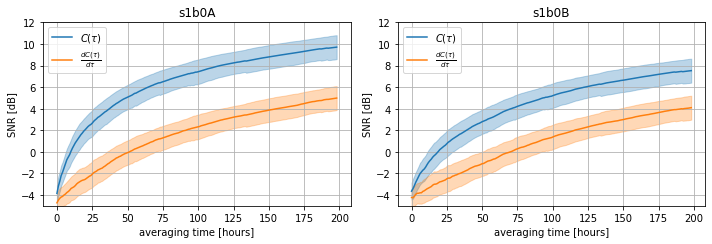

In [37]:
fig = plt.figure(figsize=(10,3.5))

plt.subplot(1,2,1)
emerge['s1b0A'].mean('longtime').plot(label='$C(\\tau)$')
d_emerge['s1b0A'].mean('longtime').plot(label='$\\frac{dC(\\tau)}{d\\tau}$')

plt.fill_between(
    emerge.shorttime,
    emerge['s1b0A'].mean('longtime') - emerge['s1b0A'].std('longtime')/2,
    emerge['s1b0A'].mean('longtime') + emerge['s1b0A'].std('longtime')/2,
    color='C0',
    alpha=0.3
)

plt.fill_between(
    d_emerge.shorttime,
    d_emerge['s1b0A'].mean('longtime') - emerge['s1b0A'].std('longtime')/2,
    d_emerge['s1b0A'].mean('longtime') + emerge['s1b0A'].std('longtime')/2,
    color='C1',
    alpha=0.3
)

plt.legend()
plt.title('s1b0A')
plt.xlabel('averaging time [hours]')
plt.ylabel('SNR [dB]')
plt.grid()
plt.ylim([-5,12])

plt.subplot(1,2,2)
emerge['s1b0B'].mean('longtime').plot(label='$C(\\tau)$')
d_emerge['s1b0B'].mean('longtime').plot(label='$\\frac{dC(\\tau)}{d\\tau}$')

plt.fill_between(
    emerge.shorttime,
    emerge['s1b0B'].mean('longtime') - emerge['s1b0A'].std('longtime')/2,
    emerge['s1b0B'].mean('longtime') + emerge['s1b0A'].std('longtime')/2,
    color='C0',
    alpha=0.3
)

plt.fill_between(
    d_emerge.shorttime,
    d_emerge['s1b0B'].mean('longtime') - emerge['s1b0A'].std('longtime')/2,
    d_emerge['s1b0B'].mean('longtime') + emerge['s1b0A'].std('longtime')/2,
    color='C1',
    alpha=0.3
)

plt.legend()
plt.title('s1b0B')
plt.xlabel('averaging time [hours]')
plt.ylabel('SNR [dB]')
plt.grid()
plt.ylim([-5,12])

plt.tight_layout()
fig.savefig('figures/derivative_emergence.svg')

## Peak Spectrums

In [48]:
ds1b0Af = xrft.fft(dNCCFs.sel({'delay':slice(-3.5,-2.5)})[::201,:], dim='delay').compute().dropna('time').interp({'freq_delay':np.linspace(0,100,500)}, method='cubic')
s1b0Af = xrft.fft(NCCFs.sel({'delay':slice(-3.5,-2.5)})[::201,:], dim='delay').compute().dropna('time').interp({'freq_delay':np.linspace(0,100,500)}, method='cubic')

In [63]:
s1b0Af.freq_delay

<xarray.DataArray 'freq_delay' (freq_delay: 500)>
array([  0.      ,   0.200401,   0.400802, ...,  99.599198,  99.799599,
       100.      ])
Coordinates:
  * freq_delay  (freq_delay) float64 0.0 0.2004 0.4008 ... 99.6 99.8 100.0
Attributes:
    spacing:     1.000000000000199
    direct_lag:  -2.9950000000053727

In [71]:
for k in range(306):
    (np.abs(ds1b0Af[k,:])/np.abs(ds1b0Af[k,:]).max()).plot(alpha=0.005, c='blue')
    (np.abs(s1b0Af[k,:]*1j*2*np.pi*s1b0Af.freq_delay)/(np.abs(s1b0Af[k,:]*1j*2*np.pi*s1b0Af.freq_delay).max())).plot(alpha=0.005, c='red')

omega = 2*np.pi*np.linspace(0, 100, 1000)
plt.plot(omega, c='k')
plt.yscale('log')
#plt.ylim([1e-3,1e1])
plt.xlim([0,90])
plt.xlabel('frequency [Hz]')
plt.grid()

## tradeoff study

In [4]:
atd = inversion.calculate_arrival_times(dNCCFs, dim='delay', peaks={'s1b0A':slice(-3.5, -2.5), 's1b0B':slice(2.5, 3.5)})

TypeError: unexpected indexer type for VectorizedIndexer: dask.array<sub, shape=(61028,), dtype=int64, chunksize=(100,), chunktype=numpy.ndarray>

In [ ]:
atd = inversion.calculate_arrival_times(NCCFs, dim='delay', peaks={'s1b0A':slice(-3.5, -2.5), 's1b0B':slice(2.5, 3.5)})